In [1]:
from urllib.request import urlopen
from bs4 import BeautifulSoup
import requests
import pandas as pd
import re
import mechanicalsoup
import pandas as pd
from pymongo import MongoClient
from multiprocessing import Process
import os
from signal import SIGINT
from threading import Timer

In [2]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import sent_tokenize, word_tokenize
from Sastrawi.Stemmer.StemmerFactory import StemmerFactory

In [3]:
#connect to mongo localhost
conn = MongoClient('localhost', 27017)
db = conn.pi

#stemmer
factory = StemmerFactory()
stemmer = factory.create_stemmer()

In [4]:
#entering collection
data = db.kompas_data

In [5]:
ids = []
title = []
content = []
label = []
created_date = []
get_published_date = []
keywords = []

In [6]:
for i in data.find():
    ids.append(i.get('id'))
    title.append(i.get('title'))
    content.append(i.get('content'))
    label.append(i.get('label'))
    created_date.append(i.get('created date'))
    get_published_date.append(i.get('get published date'))
    keywords.append(i.get('keywords'))

In [23]:
published_date_only = []
published_time_only = []

for i in get_published_date:
    time = i.split(" ")
    published_date_only.append(time[0])
    published_time_only.append(time[1])

In [24]:
datas = {'id': ids, 'title': title, 'content':content, 'label':label, 'published_date': published_date_only, 'published_time': published_time_only, 'keywords': keywords}

In [25]:
df = pd.DataFrame.from_dict(datas)
df

,id,title,content,label,published_date,published_time,keywords
0,15989820,"AC Toyota Innova Reborn Tiba-tiba Panas, Ini P...","\n\nJAKARTA, KOMPAS.com - Toyota Innova Reborn...",Otomotif,2023-07-03,16:01:00,"toyota innova, Innova Reborn, Toyota Innova Re..."
1,81270875,"Jadwal Siaran Langsung Persija Vs PSM, Tayang ...",\n\nKOMPAS.com - Jadwal Liga 1 2023-2023 hari ...,Bola,2023-07-03,16:00:00,"Liga 1, Persija, Persija vs PSM, PSM, Persija ..."
2,261234624,"Cegah Penyelundupan, Pupuk Indonesia Percanggi...","\nGIANYAR, KOMPAS.com - PT Pupuk Indonesia (Pe...",Money,2023-07-03,16:00:00,"Jakarta, Pupuk Indonesia, pupuk subsidi"
3,211099002,"Tahukah Anda, Nama Lain Bola-bola di Trotoar a...","\nJAKARTA, KOMPAS.com - Tahukah Anda bahwa bol...",Properti,2023-07-03,16:00:00,"trotoar, bollard, Kementerian PUPR, Indonesia,..."
4,8615328,MCF-Gudeg Mbah Putri Kampanyekan Menu Lezat Se...,"\nJAKARTA, KOMPAS.com - Selaras dengan kampany...",Lestari,2023-07-03,16:00:00,"Masakan Nusantara, SDG03-Kehidupan Sehat dan S..."
...,...,...,...,...,...,...,...
12444,6554801,Video Viral WNA Lakukan Asusila di Pinggir Pan...,\n\nKOMPAS.com - Video dua warga negara asing ...,Tren,2023-07-31,10:15:00,"video viral, pantai canggu, video wna mesum di..."
12445,15991156,Syarat Dapat Servis Gratis untuk Mobil Baru di...,"\n\nCILACAP, KOMPAS.com - Servis gratis kerap ...",Otomotif,2023-07-31,10:12:00,"servis gratis, kupon servis gratis, servis gra..."
12446,7519684,"Resep Rujak Petis, Isi Potongan Buah-buahan ya...",\n\nKOMPAS.com - Kamu suka dengan olahan buah-...,Food,2023-07-31,10:11:00,"gramedia.com, rujak petis, rujak buah, petis u..."
12447,12169473,"11 Tahun Dikerjakan, Sodetan Ciliwung Akhirnya...","\nJAKARTA, KOMPAS.com - Presiden Joko Widodo (...",News,2023-07-31,10:10:52,"Ciliwung, Banjir Jakarta, Jokowi, sodetan Cili..."


In [26]:
df['label'].value_counts()

News           2919
Regional       2100
Hype           1049
Money           814
Bola            692
Otomotif        690
Tren            672
Tekno           412
Edukasi         372
Travel          319
Lifestyle       287
Properti        277
Homey           259
Global          257
Food            249
Skola           181
Health          170
Lestari         139
Sains           139
Advertorial     123
Cek fakta       110
Stori            77
Agri             72
Umkm             64
Katanetizen       6
Name: label, dtype: int64

In [27]:
df.isna().sum()

id                 84
title               0
content           149
label               0
published_date      0
published_time      0
keywords            0
dtype: int64

In [28]:
df = df.dropna(axis=0)
df.drop_duplicates()

In [29]:
df

,id,title,content,label,published_date,published_time,keywords
0,15989820,"AC Toyota Innova Reborn Tiba-tiba Panas, Ini P...","\n\nJAKARTA, KOMPAS.com - Toyota Innova Reborn...",Otomotif,2023-07-03,16:01:00,"toyota innova, Innova Reborn, Toyota Innova Re..."
1,81270875,"Jadwal Siaran Langsung Persija Vs PSM, Tayang ...",\n\nKOMPAS.com - Jadwal Liga 1 2023-2023 hari ...,Bola,2023-07-03,16:00:00,"Liga 1, Persija, Persija vs PSM, PSM, Persija ..."
2,261234624,"Cegah Penyelundupan, Pupuk Indonesia Percanggi...","\nGIANYAR, KOMPAS.com - PT Pupuk Indonesia (Pe...",Money,2023-07-03,16:00:00,"Jakarta, Pupuk Indonesia, pupuk subsidi"
3,211099002,"Tahukah Anda, Nama Lain Bola-bola di Trotoar a...","\nJAKARTA, KOMPAS.com - Tahukah Anda bahwa bol...",Properti,2023-07-03,16:00:00,"trotoar, bollard, Kementerian PUPR, Indonesia,..."
4,8615328,MCF-Gudeg Mbah Putri Kampanyekan Menu Lezat Se...,"\nJAKARTA, KOMPAS.com - Selaras dengan kampany...",Lestari,2023-07-03,16:00:00,"Masakan Nusantara, SDG03-Kehidupan Sehat dan S..."
...,...,...,...,...,...,...,...
12444,6554801,Video Viral WNA Lakukan Asusila di Pinggir Pan...,\n\nKOMPAS.com - Video dua warga negara asing ...,Tren,2023-07-31,10:15:00,"video viral, pantai canggu, video wna mesum di..."
12445,15991156,Syarat Dapat Servis Gratis untuk Mobil Baru di...,"\n\nCILACAP, KOMPAS.com - Servis gratis kerap ...",Otomotif,2023-07-31,10:12:00,"servis gratis, kupon servis gratis, servis gra..."
12446,7519684,"Resep Rujak Petis, Isi Potongan Buah-buahan ya...",\n\nKOMPAS.com - Kamu suka dengan olahan buah-...,Food,2023-07-31,10:11:00,"gramedia.com, rujak petis, rujak buah, petis u..."
12447,12169473,"11 Tahun Dikerjakan, Sodetan Ciliwung Akhirnya...","\nJAKARTA, KOMPAS.com - Presiden Joko Widodo (...",News,2023-07-31,10:10:52,"Ciliwung, Banjir Jakarta, Jokowi, sodetan Cili..."


In [30]:
df['title'] = df['title'].str.lower()
df['label'] = df['label'].str.lower()
df['content'] = df['content'].str.lower()

C:\Users\LEGION\AppData\Local\Temp\ipykernel_13864\1538813693.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['title'] = df['title'].str.lower()
C:\Users\LEGION\AppData\Local\Temp\ipykernel_13864\1538813693.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['label'] = df['label'].str.lower()
C:\Users\LEGION\AppData\Local\Temp\ipykernel_13864\1538813693.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value 

In [31]:
for i in df.index:
    tes = re.sub("\s\s+" , " ", df['content'][i])
    tes = re.sub(r'[^\w]', ' ', tes)
    tes = re.sub("\s\s+" , " ", tes)

    tokenize = word_tokenize(tes)
    tes = [word for word in tokenize if not word in stopwords.words('indonesian')]
    tes = " ".join(tes)
#     tes = stemmer.stem(tes)
    df['content'][i] = tes

C:\Users\LEGION\AppData\Local\Temp\ipykernel_13864\144100510.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['content'][i] = tes


In [32]:
df['content'] = df['content'].str.replace(' klik ', ' ')
df['content'] = df['content'].str.replace(' link ', ' ')
df['content'] = df['content'].str.replace(' https ', ' ')
df['content'] = df['content'].str.replace(' baca ', ' ')
df['content'] = df['content'].str.replace(' update ', ' ')
df['content'] = df['content'].str.replace(' telegram ', ' ')
df['content'] = df['content'].str.replace(' breaking news ', ' ')
df['content'] = df['content'].str.replace('kompas com news me aplikasi ponsel', ' ')
df['content'] = df['content'].str.replace('dapatkan kompas com grup', ' ')
df['content'] = df['content'].str.replace(' berita pilihan ', ' ')
df['content'] = df['content'].str.replace(' pilihan kompas ', ' ')
df['content'] = df['content'].str.replace(' mari bergabung ', ' ')
df['content'] = df['content'].str.replace(' t ', ' ')
df['content'] = df['content'].str.replace('kompascomupdate', '')
df['content'] = df['content'].str.replace(' join install ', '')
df['content'] = df['content'].str.replace(' join ', '')
df['content'] = df['content'].str.replace('me aplikasi ponsel', ' ')
df['content'] = df['content'].replace('me aplikasi ponsel', ' ')
df['content'] = df['content'].str.replace(' kompas com ', '')
df['content'] = df['content'].str.replace(' dapatkangrupnews ', ' ')

C:\Users\LEGION\AppData\Local\Temp\ipykernel_13864\2212014328.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['content'] = df['content'].str.replace(' klik ', ' ')
C:\Users\LEGION\AppData\Local\Temp\ipykernel_13864\2212014328.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['content'] = df['content'].str.replace(' link ', ' ')
C:\Users\LEGION\AppData\Local\Temp\ipykernel_13864\2212014328.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

In [33]:
import numpy as np
import matplotlib.pyplot as plt
from wordcloud import WordCloud

In [34]:
a=""
for j in df['content']:
    a = a+" "+j
a

' jakartatoyota innova reborn pilihan keluarga indonesia mobil sehari harga bekasnya stabil angka rp 250 juta rp 300 jutaan tergantung tipe pemilik calon pemilik innova reborn ac panas suhunya setelan ac posisinya dipasang suhu rendah udara kisi kisi panas bikin penumpang nyaman suparna kepala bengkel auto2000 pramuka innova reborn tipe tertinggi cbu indonesia toyota innova zenix meluncur malaysia dok bobby spec rare item toyota kijang innova reborn tipe e dimodifikasi tipe venturer tipe auto digital setelan ac suparnasenin 3 7 2023 innova reborn varian venturer setelan ac digital fitur auto pemanas heater penyebab ac panas komponen motor servo rusak motor servo motor berguna mengatur panas dinginnya ac motor servo innova reborn sederhana suparna po mahendra transport sopir wanita suparna mobil memiliki ac dual zone triple zone motor servo kompleks innova fitur komponennya mahal diperbaiki komponen motor servo rusak komponen elektronik usianya 4 7 rusak suparna gejala ac panas ditemui 

In [35]:
wc = WordCloud(
    background_color='white',
    max_words=5000)

wc.generate(a)

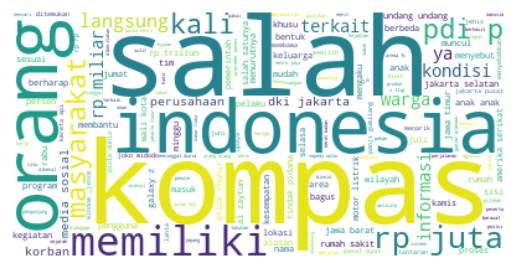

In [36]:
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.show()

In [37]:
for i in df.index:
    tes = re.sub("\s\s+" , " ", df['content'][i])
    tes = tes.split()
    tes = " ".join(tes[3:])
    df['content'][i] = tes

C:\Users\LEGION\AppData\Local\Temp\ipykernel_13864\1598909027.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['content'][i] = tes


In [38]:
df

,id,title,content,label,published_date,published_time,keywords
0,15989820,"ac toyota innova reborn tiba-tiba panas, ini p...",pilihan keluarga indonesia mobil sehari harga ...,otomotif,2023-07-03,16:01:00,"toyota innova, Innova Reborn, Toyota Innova Re..."
1,81270875,"jadwal siaran langsung persija vs psm, tayang ...",liga 1 2023 2023 senin 3 7 2023 menyajikan big...,bola,2023-07-03,16:00:00,"Liga 1, Persija, Persija vs PSM, PSM, Persija ..."
2,261234624,"cegah penyelundupan, pupuk indonesia percanggi...",persero mendorong penggunaan aplikasi i pubers...,money,2023-07-03,16:00:00,"Jakarta, Pupuk Indonesia, pupuk subsidi"
3,211099002,"tahukah anda, nama lain bola-bola di trotoar a...",dipasang sisi trotoar bersebelahan jalan raya ...,properti,2023-07-03,16:00:00,"trotoar, bollard, Kementerian PUPR, Indonesia,..."
4,8615328,mcf-gudeg mbah putri kampanyekan menu lezat se...,indonesia spice up the world marisza cardoba f...,lestari,2023-07-03,16:00:00,"Masakan Nusantara, SDG03-Kehidupan Sehat dan S..."
...,...,...,...,...,...,...,...
12444,6554801,video viral wna lakukan asusila di pinggir pan...,warga negara asing wna tindak asusila beredar ...,tren,2023-07-31,10:15:00,"video viral, pantai canggu, video wna mesum di..."
12445,15991156,syarat dapat servis gratis untuk mobil baru di...,dijadikan program penjualan mobil informasi te...,otomotif,2023-07-31,10:12:00,"servis gratis, kupon servis gratis, servis gra..."
12446,7519684,"resep rujak petis, isi potongan buah-buahan ya...",olahan buah buahan resep rujak petis potongan ...,food,2023-07-31,10:11:00,"gramedia.com, rujak petis, rujak buah, petis u..."
12447,12169473,"11 tahun dikerjakan, sodetan ciliwung akhirnya...",jokowi meresmikan proyek sodetan sungai ciliwu...,news,2023-07-31,10:10:52,"Ciliwung, Banjir Jakarta, Jokowi, sodetan Cili..."


In [39]:
import pickle
import joblib

vectorizer = pickle.load(open("feature_fix.pkl", "rb"))

In [40]:
xgb = joblib.load("xgb.joblib")

In [41]:
X_pred = vectorizer.transform(df['content'])

In [42]:
y_pred = xgb.predict(X_pred.toarray())
y_pred

array([1, 1, 1, ..., 1, 2, 0], dtype=int64)

In [43]:
datas = {'id': ids, 'title': title, 'content':content, 'label':label, 'created_date':created_date, 'created_time':created_date, 'published_date': published_date_only, 'published_time': published_time_only, 'keywords': keywords, 'sentimen': y_pred}

In [44]:
df['sentimen'] = y_pred
df

C:\Users\LEGION\AppData\Local\Temp\ipykernel_13864\1005098400.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['sentimen'] = y_pred


,id,title,content,label,published_date,published_time,keywords,sentimen
0,15989820,"ac toyota innova reborn tiba-tiba panas, ini p...",pilihan keluarga indonesia mobil sehari harga ...,otomotif,2023-07-03,16:01:00,"toyota innova, Innova Reborn, Toyota Innova Re...",1
1,81270875,"jadwal siaran langsung persija vs psm, tayang ...",liga 1 2023 2023 senin 3 7 2023 menyajikan big...,bola,2023-07-03,16:00:00,"Liga 1, Persija, Persija vs PSM, PSM, Persija ...",1
2,261234624,"cegah penyelundupan, pupuk indonesia percanggi...",persero mendorong penggunaan aplikasi i pubers...,money,2023-07-03,16:00:00,"Jakarta, Pupuk Indonesia, pupuk subsidi",1
3,211099002,"tahukah anda, nama lain bola-bola di trotoar a...",dipasang sisi trotoar bersebelahan jalan raya ...,properti,2023-07-03,16:00:00,"trotoar, bollard, Kementerian PUPR, Indonesia,...",1
4,8615328,mcf-gudeg mbah putri kampanyekan menu lezat se...,indonesia spice up the world marisza cardoba f...,lestari,2023-07-03,16:00:00,"Masakan Nusantara, SDG03-Kehidupan Sehat dan S...",1
...,...,...,...,...,...,...,...,...
12444,6554801,video viral wna lakukan asusila di pinggir pan...,warga negara asing wna tindak asusila beredar ...,tren,2023-07-31,10:15:00,"video viral, pantai canggu, video wna mesum di...",2
12445,15991156,syarat dapat servis gratis untuk mobil baru di...,dijadikan program penjualan mobil informasi te...,otomotif,2023-07-31,10:12:00,"servis gratis, kupon servis gratis, servis gra...",1
12446,7519684,"resep rujak petis, isi potongan buah-buahan ya...",olahan buah buahan resep rujak petis potongan ...,food,2023-07-31,10:11:00,"gramedia.com, rujak petis, rujak buah, petis u...",1
12447,12169473,"11 tahun dikerjakan, sodetan ciliwung akhirnya...",jokowi meresmikan proyek sodetan sungai ciliwu...,news,2023-07-31,10:10:52,"Ciliwung, Banjir Jakarta, Jokowi, sodetan Cili...",2


In [45]:
df['sentimen'] = df['sentimen'].replace(0, 'Netral')
df['sentimen'] = df['sentimen'].replace(1, 'Positif')
df['sentimen'] = df['sentimen'].replace(2, 'Negatif')
df

C:\Users\LEGION\AppData\Local\Temp\ipykernel_13864\176507593.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['sentimen'] = df['sentimen'].replace(0, 'Netral')
C:\Users\LEGION\AppData\Local\Temp\ipykernel_13864\176507593.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['sentimen'] = df['sentimen'].replace(1, 'Positif')
C:\Users\LEGION\AppData\Local\Temp\ipykernel_13864\176507593.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_i

,id,title,content,label,published_date,published_time,keywords,sentimen
0,15989820,"ac toyota innova reborn tiba-tiba panas, ini p...",pilihan keluarga indonesia mobil sehari harga ...,otomotif,2023-07-03,16:01:00,"toyota innova, Innova Reborn, Toyota Innova Re...",Positif
1,81270875,"jadwal siaran langsung persija vs psm, tayang ...",liga 1 2023 2023 senin 3 7 2023 menyajikan big...,bola,2023-07-03,16:00:00,"Liga 1, Persija, Persija vs PSM, PSM, Persija ...",Positif
2,261234624,"cegah penyelundupan, pupuk indonesia percanggi...",persero mendorong penggunaan aplikasi i pubers...,money,2023-07-03,16:00:00,"Jakarta, Pupuk Indonesia, pupuk subsidi",Positif
3,211099002,"tahukah anda, nama lain bola-bola di trotoar a...",dipasang sisi trotoar bersebelahan jalan raya ...,properti,2023-07-03,16:00:00,"trotoar, bollard, Kementerian PUPR, Indonesia,...",Positif
4,8615328,mcf-gudeg mbah putri kampanyekan menu lezat se...,indonesia spice up the world marisza cardoba f...,lestari,2023-07-03,16:00:00,"Masakan Nusantara, SDG03-Kehidupan Sehat dan S...",Positif
...,...,...,...,...,...,...,...,...
12444,6554801,video viral wna lakukan asusila di pinggir pan...,warga negara asing wna tindak asusila beredar ...,tren,2023-07-31,10:15:00,"video viral, pantai canggu, video wna mesum di...",Negatif
12445,15991156,syarat dapat servis gratis untuk mobil baru di...,dijadikan program penjualan mobil informasi te...,otomotif,2023-07-31,10:12:00,"servis gratis, kupon servis gratis, servis gra...",Positif
12446,7519684,"resep rujak petis, isi potongan buah-buahan ya...",olahan buah buahan resep rujak petis potongan ...,food,2023-07-31,10:11:00,"gramedia.com, rujak petis, rujak buah, petis u...",Positif
12447,12169473,"11 tahun dikerjakan, sodetan ciliwung akhirnya...",jokowi meresmikan proyek sodetan sungai ciliwu...,news,2023-07-31,10:10:52,"Ciliwung, Banjir Jakarta, Jokowi, sodetan Cili...",Negatif


In [46]:
coll_processed = db.processed_datas

In [47]:
for i in df.index:
    coll_processed.insert_one({"id": df['id'][i], "title": df['title'][i], "content": df['content'][i], "label": df['label'][i], "created_date": None, "created_time": None, "published_date": df['published_date'][i], "published_time": df['published_time'][i], "keywords": df['keywords'][i], "sumber": "kompas", "sentimen":df['sentimen'][i]})